In [1]:
import mysql.connector
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import sys
from IPython.display import HTML
from matplotlib import pyplot as plt
from celluloid import Camera
import plotly.graph_objects as go

import networkx as nx

from IPython.display import HTML
from matplotlib import pyplot as plt
from celluloid import Camera

In [2]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  passwd="enron",
  database="emails",
  auth_plugin='mysql_native_password'
)

In [3]:
mycursor = mydb.cursor()

# Extract Data to Pandas

mycursor.execute("SELECT * FROM message")

myresult = mycursor.fetchall()

email_df = pd.DataFrame(myresult)

email_df.columns = ['mid','sender','date','message_id','subject','body','folder']



mycursor.execute("SELECT * FROM employeelist")

myresult = mycursor.fetchall()

employee_df = pd.DataFrame(myresult)

employee_df.columns = ['eid','first_name','last_name','email_id']



mycursor.execute("SELECT * FROM recipientinfo")

myresult = mycursor.fetchall()

recipient_df = pd.DataFrame(myresult)

recipient_df.columns = ['rid','mid','r_type','r_value','date_r']



mycursor.execute("SELECT * FROM referenceinfo")

myresult = mycursor.fetchall()

reference_df = pd.DataFrame(myresult)

reference_df.columns = ['rfid','mid','reference']



# Data Frame Characteristics

In [4]:
jobs = pd.read_csv('Data/Enron_jobs.csv')
employee_df = pd.merge(employee_df,jobs,on='email_id',how='left')
job_dict = {}
level_dict = {}

In [5]:
employee_df

,eid,first_name,last_name,email_id,Unnamed: 0,name,job_rank,job_title
0,18,Lynn,Blair,lynn.blair@enron.com,108.0,Lynn Blair,NaN,NaN
1,17,Mike,Grigsby,mike.grigsby@enron.com,126.0,Michael Grigsby,Manager,NaN
2,16,Michelle,Cash,michelle.cash@enron.com,123.0,Michelle Cash,NaN,NaN
3,15,Monika,Causholli,monika.causholli@enron.com,131.0,Monika Causholli,Employee,Analyst Risk Management
4,14,Richard,Sanders,b..sanders@enron.com,12.0,Richard Sanders,Vice President,Enron WholeSale Services
5,13,Marie,Heard,marie.heard@enron.com,110.0,Marie Heard,NaN,NaN
6,12,Paul,Lucci,t..lucci@enron.com,175.0,Paul Lucci,Employee,NaN
7,11,Mark,Whitt,mark.whitt@enron.com,115.0,Mark Whitt,NaN,NaN
8,10,Phillip,Allen,k..allen@enron.com,89.0,Philip Allen,Manager,NaN
9,9,Stephanie,Panus,stephanie.panus@enron.com,163.0,Stephanie Panus,Employee,NaN


In [6]:
for email,level,job in zip(employee_df['email_id'],employee_df['job_rank'],employee_df['job_title']):
    job_dict[email] = job
    level_dict[email] = level

In [7]:
main_emails = list(employee_df['email_id'])

In [8]:
len(recipient_df)

2064442

In [9]:
recipient_df = recipient_df[[email in main_emails for email in recipient_df['r_value']]]

In [10]:
len(email_df)

252759

In [11]:
email_df = email_df[[email in main_emails for email in email_df['sender']]]

In [12]:
len(set(recipient_df['mid']))

110187

In [13]:
len(email_df)

87120

In [14]:
# create mapping of messages to lists of recipients and how many recipients that email has
mid_dict = {}
count =0
total = len(recipient_df)
for mid,r_value in zip(recipient_df['mid'],recipient_df['r_value']) :
    if mid in mid_dict.keys():
        mid_dict[mid].append(r_value)
    else:
        mid_dict[mid] = [r_value]

(0, 5000)

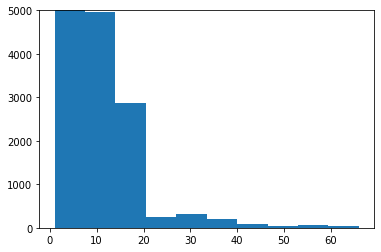

In [15]:
network_df = pd.DataFrame()

network_df['mid'] = list(set(recipient_df['mid']))


lst = []
lst_num = []
for mid in network_df['mid']:
    lst.append(mid_dict[mid])
    lst_num.append(len(mid_dict[mid]))
network_df['rec_list'] = lst
network_df['rec_count'] = lst_num


plt.hist(network_df['rec_count'])
plt.ylim(0,5000)

In [16]:
network_df = network_df.merge(email_df[['mid','sender','date']])

network_df.head()

,mid,rec_list,rec_count,sender,date
0,76,"[sean.crandall@enron.com, mike.swerzbin@enron....",3,mary.hain@enron.com,2000-08-17 07:11:00
1,93,[robert.badeer@enron.com],1,cooper.richey@enron.com,2000-08-23 04:39:00
2,159,"[robert.badeer@enron.com, mike.swerzbin@enron....",2,mary.hain@enron.com,2000-08-29 06:28:00
3,465,[richard.shapiro@enron.com],1,jeff.dasovich@enron.com,2000-08-07 12:23:00
4,517,[richard.shapiro@enron.com],1,jeff.dasovich@enron.com,2000-08-10 03:12:00


In [17]:
sender_total_dict = {}
for sender in email_df['sender']:
    if sender in sender_total_dict:
        sender_total_dict[sender] += 1
    else:
        sender_total_dict[sender] = 1

recer_total_dict = {}
for recer in recipient_df['r_value']:
    if recer in recer_total_dict:
        recer_total_dict[recer] += 1
    else:
        recer_total_dict[recer] = 1

In [18]:
sender_count_dict = {}
for sender in set(network_df['sender']):
    sender_count_dict[sender] = len(set(network_df[network_df['sender']==sender]['mid']))


In [19]:
for send in network_df['sender']:
    if send not in main_emails:
        print('fail')

In [20]:
for rec in network_df['rec_list']:
    for recer in rec:
        if recer not in main_emails:
            print('fail')

In [21]:
email_to_id = {}
id_to_email ={}
count = 0
for user in main_emails:
    email_to_id[user] = count
    id_to_email[count] = user
    count+=1

In [22]:
jeff_id = email_to_id['jeff.skilling@enron.com']
jeff_id

129

In [23]:
# Create Key Players Matrix

In [24]:
user_matrix = np.zeros((len(main_emails),len(main_emails)))

In [25]:
for sender ,rec_list,rec_count in zip(network_df['sender'],network_df['rec_list'],network_df['rec_count']):
    for recer in rec_list:
        user_matrix[email_to_id[sender]][email_to_id[recer]] += (1/rec_count)*sender_count_dict[sender]

In [26]:
G = nx.Graph()

In [27]:
G.add_nodes_from(range(len(user_matrix)))

In [28]:
# create list of edge weights to cut by percentile
edge_values = list(user_matrix)
l =[]
for edges in edge_values:
    l = l + list(edges)
edge_values = l

In [29]:
edge_thresh = np.percentile(edge_values,95)
for i in range(len(user_matrix)):
    for j in range(len(user_matrix)):
        #if i ==jeff_sig_id:
                #print('jeff_potential')
        if user_matrix[i][j] > edge_thresh:
            if i ==jeff_id:
                print('jeff_connection')
            G.add_edge(i,j)

In [30]:
jeff_dist_dict = list((nx.all_pairs_shortest_path_length(G)))[jeff_id][1]
len(jeff_dist_dict)

147

In [31]:
# remove Nodes that do not touch Jeff
for i in range(len(main_emails)):
    if i not in jeff_dist_dict:
        G.remove_node(i)
        
#Jeff Check
email_to_id['jeff.skilling@enron.com'] in list(G.nodes())

True

In [32]:
jeff_groups = []
for i in range(10):
    i_range_list = []
    for key,value in jeff_dist_dict.items():
        if jeff_dist_dict[key] ==i:
            i_range_list.append(key)
    jeff_groups.append(i_range_list)
while [] in jeff_groups:
    jeff_groups.remove([])

In [33]:
plotly_color = ['red','orange','yellow','purple','green','black','black','black','black','black','black']
node_size = [900,600,400,300,200,100,100,100,100,100]

jeff_colors_plotly = []
jeff_size = []


for node_num in list(G.nodes()):
    jeff_colors_plotly.append(plotly_color[jeff_dist_dict[node_num]])
    jeff_size.append(node_size[jeff_dist_dict[node_num]])

In [34]:
#tree pos
pos = {}
for i in range(len(jeff_groups)):
    x = -1 + i/5
    for j in range(len(jeff_groups[i])):
        pos[jeff_groups[i][j]] = (x,1/(len(jeff_groups[i]))*j) 

#pos = nx.shell_layout(G,nlist=jeff_groups)
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.append(x0)
    edge_x.append(x1)
    edge_x.append(None)
    edge_y.append(y0)
    edge_y.append(y1)
    edge_y.append(None)


edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

node_x = []
node_y = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    hoverinfo='text',
    marker=dict(
        showscale=True,
        # colorscale options
        #'Greys' | 'YlGnBu' | 'Greens' | 'YlOrRd' | 'Bluered' | 'RdBu' |
        #'Reds' | 'Blues' | 'Picnic' | 'Rainbow' | 'Portland' | 'Jet' |
        #'Hot' | 'Blackbody' | 'Earth' | 'Electric' | 'Viridis' |
        colorscale='YlGnBu',
        reversescale=True,
        color=[],
        size=10,
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line_width=2))

In [39]:
node_adjacencies = []
node_text = []
for node, adjacencies in enumerate(G.adjacency()):
    node_adjacencies.append(len(adjacencies[1]))
    
for node in G.node:
    text_string = ''
    text_string = text_string + id_to_email[node]
    text_string = text_string + ' level: '+  str(level_dict[id_to_email[node]]) + '\ntitle: ' +str( job_dict[id_to_email[node]])
    node_text.append(text_string)
        

node_trace.marker.color = jeff_colors_plotly
node_trace.text = node_text

In [40]:
fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='<br>Network graph made with Python',
                titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20,l=5,r=5,t=40),
                annotations=[ dict(
                    text="Python code: <a href='https://plot.ly/ipython-notebooks/network-graphs/'> https://plot.ly/ipython-notebooks/network-graphs/</a>",
                    showarrow=False,
                    xref="paper", yref="paper",
                    x=0.005, y=-0.002 ) ],
                xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                )

fig.show()

In [41]:
pos[jeff_id]

(-1.0, 0.0)

In [42]:
pd.DataFrame(pos)

,129,36,66,68,69,73,122,149,150,44,...,11,31,3,87,93,115,137,85,131,134
0,-1.0,-0.8,-0.800,-0.80,-0.800,-0.8,-0.800,-0.80,-0.800,-0.6,...,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000,-0.200000
1,0.0,0.0,0.125,0.25,0.375,0.5,0.625,0.75,0.875,0.0,...,0.090909,0.181818,0.272727,0.363636,0.454545,0.545455,0.636364,0.727273,0.818182,0.909091


In [43]:
network_df[network_df['sender']=='jeff.skilling@enron.com']

,mid,rec_list,rec_count,sender,date
804,10348,"[rick.buy@enron.com, mark.whitt@enron.com]",2,jeff.skilling@enron.com,2001-05-03 08:06:00
3183,296098,"[k..allen@enron.com, sally.beck@enron.com, ric...",15,jeff.skilling@enron.com,2001-08-01 12:25:58
3355,297582,"[k..allen@enron.com, sally.beck@enron.com, ric...",15,jeff.skilling@enron.com,2001-08-01 12:25:58
10711,113211,"[harry.arora@enron.com, chris.stokley@enron.com]",2,jeff.skilling@enron.com,2000-01-27 04:37:00
12557,398736,"[k..allen@enron.com, sally.beck@enron.com, ric...",15,jeff.skilling@enron.com,2001-08-01 12:25:58
12558,398737,"[jeff.skilling@enron.com, k..allen@enron.com, ...",16,jeff.skilling@enron.com,2001-08-01 14:01:10
12559,398739,"[shelley.corman@enron.com, drew.fossum@enron.c...",7,jeff.skilling@enron.com,2001-08-07 07:20:12
12560,398744,"[rick.buy@enron.com, louise.kitchen@enron.com,...",5,jeff.skilling@enron.com,2001-04-19 20:18:00
12561,398750,[rod.hayslett@enron.com],1,jeff.skilling@enron.com,2001-04-20 15:34:00
12573,400347,"[rick.buy@enron.com, mark.whitt@enron.com]",2,jeff.skilling@enron.com,2001-05-03 08:06:00


In [44]:
jobs = pd.read_csv('Data/Enron_jobs.csv')

jobs = []
for item in job[0]:
    temp_l = []
    temp = item.split('\t')
    temp_l.append(temp[0])
    temp = temp[1].split('  ')
    temp_l = temp_l + temp
    while '' in temp_l:
        temp_l.remove('')
    while 'xxx' in temp_l:
        temp_l.remove('xxx')
    while len(temp_l)<4:
        temp_l.append('N/A')
    jobs.append(temp_l)

jobs = pd.DataFrame(jobs)

jobs.columns = ['email_id','name','job_rank','job_title']

jobs['email_id'] = [address + '@enron.com' for address in jobs['email_id']]

jobs.to_csv('enron_jobs.csv')

In [45]:
jeff_groups

[[129],
 [36, 66, 68, 69, 73, 122, 149, 150],
 [44,
  54,
  65,
  107,
  123,
  109,
  0,
  16,
  29,
  32,
  51,
  127,
  136,
  140,
  19,
  20,
  48,
  15,
  30,
  70,
  72,
  92,
  114,
  23,
  27,
  49,
  4,
  37,
  45,
  46,
  138,
  38,
  1,
  8,
  13,
  17,
  18,
  21,
  33,
  113,
  132,
  139,
  147,
  2,
  79,
  56,
  57,
  78,
  84,
  117,
  126,
  128,
  96,
  74],
 [47,
  58,
  62,
  89,
  91,
  100,
  101,
  102,
  103,
  104,
  111,
  120,
  53,
  67,
  12,
  75,
  5,
  39,
  77,
  83,
  98,
  119,
  121,
  146,
  28,
  55,
  52,
  7,
  9,
  14,
  50,
  76,
  141,
  24,
  82,
  108,
  118,
  124,
  81,
  95,
  105,
  110,
  10,
  42,
  60,
  63,
  64,
  94,
  130,
  133,
  22,
  25,
  34,
  35,
  40,
  43,
  59,
  61,
  88,
  125,
  86,
  90,
  97,
  135,
  6,
  26,
  41,
  71,
  145,
  106,
  148,
  112,
  144],
 [80, 11, 31, 3, 87, 93, 115, 137, 85, 131, 134]]

In [46]:
pos

{129: (-1.0, 0.0),
 36: (-0.8, 0.0),
 66: (-0.8, 0.125),
 68: (-0.8, 0.25),
 69: (-0.8, 0.375),
 73: (-0.8, 0.5),
 122: (-0.8, 0.625),
 149: (-0.8, 0.75),
 150: (-0.8, 0.875),
 44: (-0.6, 0.0),
 54: (-0.6, 0.018518518518518517),
 65: (-0.6, 0.037037037037037035),
 107: (-0.6, 0.05555555555555555),
 123: (-0.6, 0.07407407407407407),
 109: (-0.6, 0.09259259259259259),
 0: (-0.6, 0.1111111111111111),
 16: (-0.6, 0.12962962962962962),
 29: (-0.6, 0.14814814814814814),
 32: (-0.6, 0.16666666666666666),
 51: (-0.6, 0.18518518518518517),
 127: (-0.6, 0.2037037037037037),
 136: (-0.6, 0.2222222222222222),
 140: (-0.6, 0.24074074074074073),
 19: (-0.6, 0.25925925925925924),
 20: (-0.6, 0.2777777777777778),
 48: (-0.6, 0.2962962962962963),
 15: (-0.6, 0.31481481481481477),
 30: (-0.6, 0.3333333333333333),
 70: (-0.6, 0.35185185185185186),
 72: (-0.6, 0.37037037037037035),
 92: (-0.6, 0.38888888888888884),
 114: (-0.6, 0.4074074074074074),
 23: (-0.6, 0.42592592592592593),
 27: (-0.6, 0.444444444

In [47]:
pos = {}
for i in range(len(jeff_groups)):
    x = -1 + i/5
    for j in range(len(jeff_groups[i])):
        pos[jeff_groups[i][j]] = (x,1/len(jeff_groups[i])*j) 
heir_pos = pos

//anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



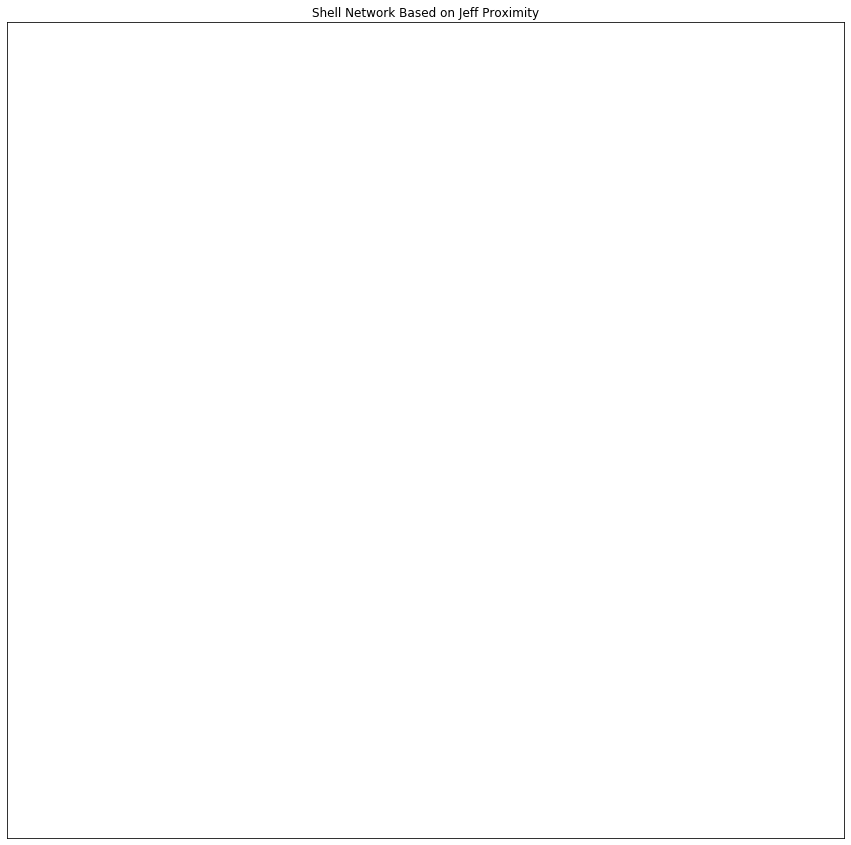

In [48]:
fig = plt.figure(figsize=(15,15))
camera = Camera(fig)
for i in range(50):

    pos = nx.spring_layout(G,iterations=i,pos=heir_pos,k=.1)
        # larger figure size
    nx.draw_networkx(G,pos,node_size=jeff_size,node_color=jeff_colors_plotly,)
    plt.title('Shell Network Based on Jeff Proximity')
    camera.snap()
    
animation = camera.animate(interval=200)
animation.save('Spring_Proximity_Jeff_from Heirarchy_model.gif', writer = 'imagemagick')
HTML(animation.to_jshtml())

In [49]:
jobs['job_rank'].isna().sum()

55

//anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



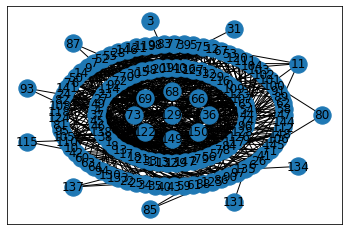

In [50]:

circ = nx.shell_layout(G,jeff_groups)
nx.draw_networkx(G,circ)

In [51]:
jeff_groups

[[129],
 [36, 66, 68, 69, 73, 122, 149, 150],
 [44,
  54,
  65,
  107,
  123,
  109,
  0,
  16,
  29,
  32,
  51,
  127,
  136,
  140,
  19,
  20,
  48,
  15,
  30,
  70,
  72,
  92,
  114,
  23,
  27,
  49,
  4,
  37,
  45,
  46,
  138,
  38,
  1,
  8,
  13,
  17,
  18,
  21,
  33,
  113,
  132,
  139,
  147,
  2,
  79,
  56,
  57,
  78,
  84,
  117,
  126,
  128,
  96,
  74],
 [47,
  58,
  62,
  89,
  91,
  100,
  101,
  102,
  103,
  104,
  111,
  120,
  53,
  67,
  12,
  75,
  5,
  39,
  77,
  83,
  98,
  119,
  121,
  146,
  28,
  55,
  52,
  7,
  9,
  14,
  50,
  76,
  141,
  24,
  82,
  108,
  118,
  124,
  81,
  95,
  105,
  110,
  10,
  42,
  60,
  63,
  64,
  94,
  130,
  133,
  22,
  25,
  34,
  35,
  40,
  43,
  59,
  61,
  88,
  125,
  86,
  90,
  97,
  135,
  6,
  26,
  41,
  71,
  145,
  106,
  148,
  112,
  144],
 [80, 11, 31, 3, 87, 93, 115, 137, 85, 131, 134]]